# Bootstrapping Deep Music Separation from Primitive Auditory Grouping Principles

Prem Seetharaman, Gordon Wichern, Jonathan Le Roux, Bryan Pardo

Abstract: Separating an audio scene, such as a cocktail party with multiple overlapping voices, into meaningful components (e.g., individual voices) is a core task in computer audition, analogous to image segmentation in computer vision. Deep networks are the state-of-the-art approach. They are typically trained on synthetic audio mixtures made from isolated sound source recordings so that ground truth for the separation is known. However, the vast majority of available audio is not isolated. The human brain performs an initial segmentation of the audio scene using primitive cues that are broadly applicable to many kinds of sound sources. We present a method to train a deep source separation model in an unsupervised way by bootstrapping using multiple primitive cues. We apply our method to train a network on a large set of unlabeled music recordings to separate vocals from accompaniment without the need for ground truth isolated sources or artificial training mixtures. A companion notebook with audio examples and code for experiments is [available](https://github.com/pseeth/bootstrapping-computer-audition).

*This notebook is a companion to the paper. The figures included in the paper are also produced here. When playing the audio, if you experience a delay between the sources in the multitrack player, stop the player and hit play again to put the tracks back in sync. Sorry about that!* 

## Contributions

We make three contributions:

1. Primitive clustering: a simple technique for combining multiple primitive-based source separation algorithms.
2. Confidence measure: a way to predict the performance of any clustering-based separation algorithm.
3. Bootstrapping: a method for training a deep model without ground truth by leveraging primitive clustering in concert with the confidence measure.


Note: all audio is at 16 kHz in experiments and in this notebook.

In [77]:
import sys
sys.path.insert(0, '..')

In [78]:
import gin
import src
import tqdm
import nussl
import matplotlib.pyplot as plt
import numpy as np
import os
import glob
import pandas as pd
import seaborn as sns
import json
import copy

sns.set(font_scale=1.2)
tqdm.tqdm.pandas()
gin.enter_interactive_mode()

## Part one: Primitive clustering

The first contribution of this paper is primitive clustering, a simple 
method for combining multiple primitive-based separation algorithms.
First, let's listen to a mixture that we'll use throughout the notebook.

In [118]:
mix = nussl.AudioSignal(
    './assets/audio/Huey Lewis - The Power Of Love.mp3', 
    offset=15, 
    duration=30
)
mix.resample(16000)
mix.embed_audio()
all_vocal_estimates = {}

We apply four primitives to this mixture, and visualize the separations
from each primitive below.

In [162]:
def separate_run_viz(mix, config_file, **kwargs):
    gin.parse_config_file(config_file)
        
    save_path = config_file.replace('.', '_').replace('/', '_')
    save_path = os.path.join('assets/audio/', save_path)
    os.makedirs(save_path, exist_ok=True)
    
    estimates = {}
    for key in ['Estimate 1', 'Estimate 2']:
        _path = os.path.join(save_path, key + '.wav')
        if os.path.exists(_path):
            estimates[key] = nussl.AudioSignal(_path, offset=15, duration=30)
    if len(estimates) != 2:
        with gin.config_scope('separator'):
            separator = src.unginify(mix, **kwargs)
        estimates = separator()
        estimates = {f'Estimate {i+1}': estimates[i] for i in range(len(estimates))}
        for key, val in estimates.items():
            val.write_audio_to_file(
                os.path.join(save_path, key + '.wav')
            )

    plt.figure(figsize=(15, 4))
    ax = plt.subplot(111)
    nussl.utils.visualize_sources_as_masks(estimates, db_cutoff=-60)
    ax.grid(False)
    plt.tight_layout()
    plt.show()
    
    nussl.play_utils.multitrack(estimates)
    return estimates

### Primitives by themselves
#### Separation via repetition

The first primitive works by separating repeating elements
from non-repeating elements.

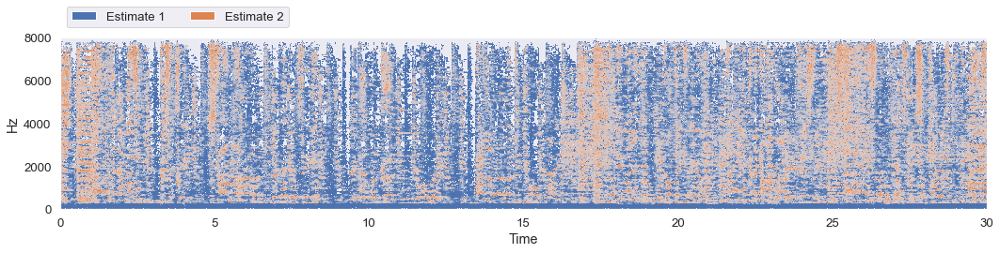


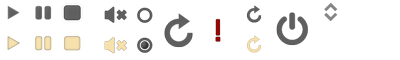
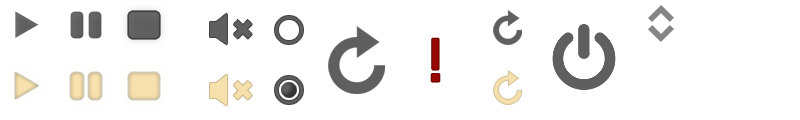
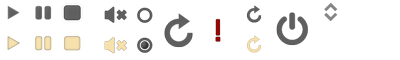

In [163]:
config_file = '../musdb/exp/primitives/2DFT-R/config.gin'
estimates = separate_run_viz(mix, config_file)
all_vocal_estimates['Repetition'] = estimates['Estimate 2']

#### Separation via micromodulation

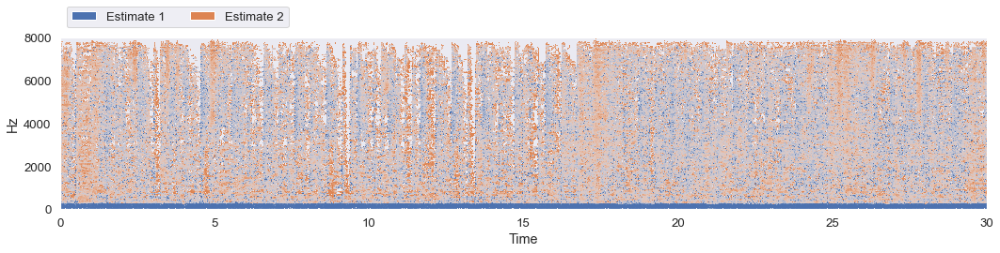


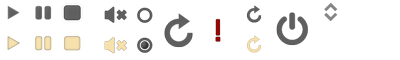
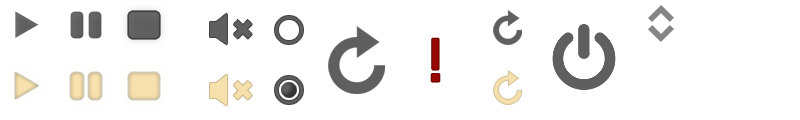
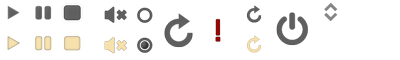

In [164]:
config_file = '../musdb/exp/primitives/2DFT-M/config.gin'
estimates = separate_run_viz(mix, config_file)
all_vocal_estimates['Micromodulation'] = estimates['Estimate 2']

#### Separation via harmonic/percussive timbre

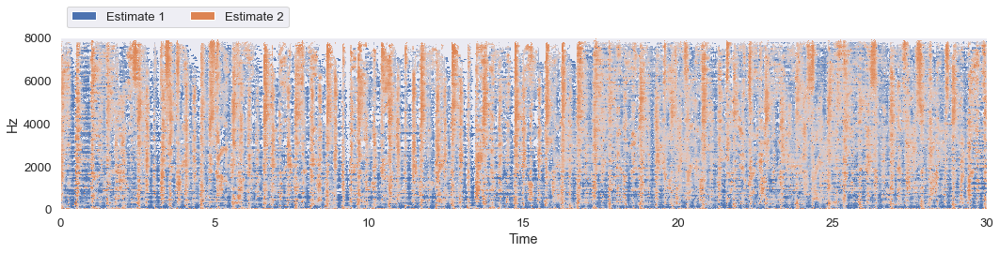


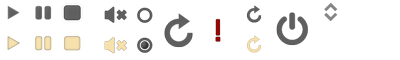
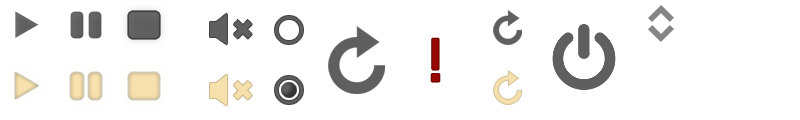
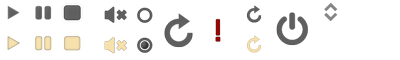

In [165]:
config_file = '../musdb/exp/primitives/HPSS/config.gin'
estimates = separate_run_viz(mix, config_file)
all_vocal_estimates['Harmonic/percussive timbre'] = estimates['Estimate 1']

#### Separation via time/pitch proximity

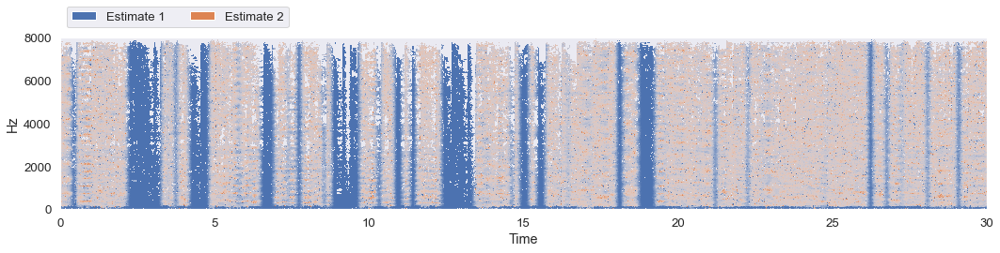


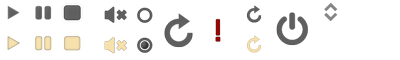
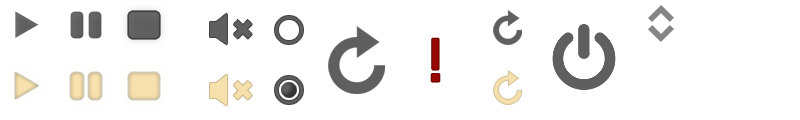
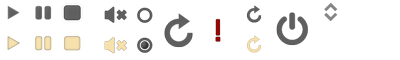

In [166]:
config_file = '../musdb/exp/primitives/MelodiaDefault/config.gin'
estimates = separate_run_viz(mix, config_file)
all_vocal_estimates['Time/pitch proximity'] = estimates['Estimate 2']

#### Primitive clustering

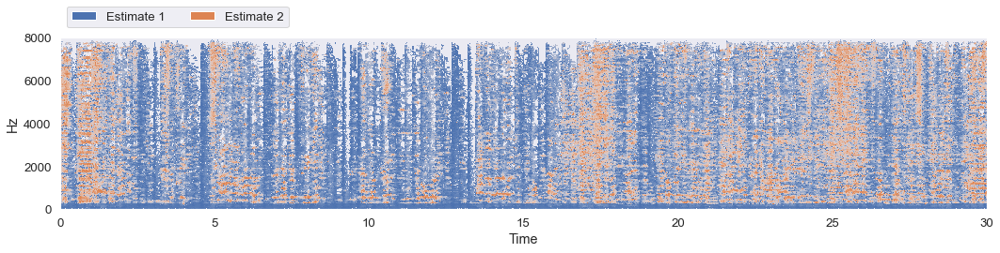


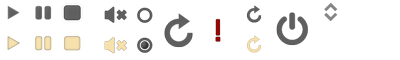
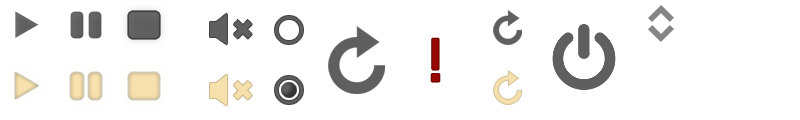
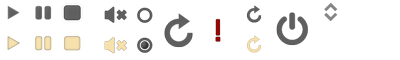

In [167]:
config_file = '../musdb/exp/primitives/PrimitiveClustering/config.gin'
estimates = separate_run_viz(mix, config_file)
all_vocal_estimates['Primitive clustering'] = estimates['Estimate 2']

### Performance of primitive clustering

We measure performance of each method on the MUSDB test set ($N=50$).
We look at the *vocal separation performance* in terms of 
scale-invariant source-to-distortion ratio *improvement*. This
is shortened to SI-SDRi. Improvement is measured by how much
better than using the mixture as the estimate is.

In [183]:
_fix_path = lambda p: p.replace('/home/pseetharaman', os.path.expanduser('~'))

def collect_results(config_file, approach, results_path='results'):
    gin.parse_config_file(config_file)
    results_folder = _fix_path(os.path.join(src.helpers.output_folder(), results_path))
    
    json_files = glob.glob(f"{results_folder}/*.json")
    df = nussl.evaluation.aggregate_score_files(json_files)
    df = df[df['source'] == 'vocals']
    
    def add_approach(row):
        row['approach'] = approach
        return row
    
    return df.apply(lambda row: add_approach(row), axis=1) 

config_files = [
    ('../musdb/exp/primitives/2DFT-R/config.gin', 'Repetition'),
    ('../musdb/exp/primitives/2DFT-M/config.gin', 'Micro-mod.'),
    ('../musdb/exp/primitives/MelodiaDefault/config.gin', 'Prox.'),
    ('../musdb/exp/primitives/HPSS/config.gin', 'Timbre'),
    ('../musdb/exp/primitives/PrimitiveClustering/config.gin', 'P. clustering')
]
dfs = []
for config_file, approach in config_files:
    dfs.append(collect_results(config_file, approach))

df = pd.concat(dfs)

def group_and_return(df, by, column):
    df2 = pd.DataFrame({col:vals[column] for col, vals in df.groupby(by)})
    meds = df2.mean().sort_values()
    return df2[meds.index]

df = group_and_return(df, 'approach', 'SI-SDRi')

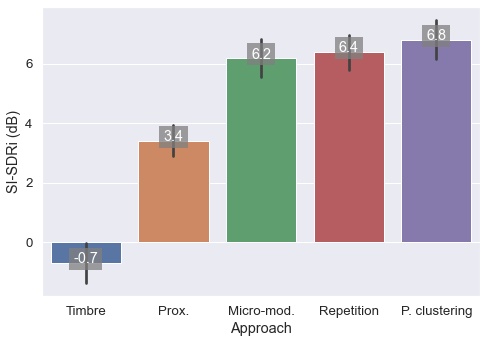

In [184]:
plt.figure(figsize=(7, 5))
ax = sns.barplot(x='variable', y='value', data=pd.melt(df))

for i, (index, row) in enumerate(df.T.iterrows()):
    t = ax.text(i, row.mean(), round(row.mean(), 1), 
            color='white', ha="center")
    t.set_bbox(dict(facecolor='gray', alpha=.75, edgecolor='none'))
    
plt.xlabel("Approach")
plt.ylabel("SI-SDRi (dB)")
plt.tight_layout()
plt.show()

We observe that primitive clustering out-performs each primitive 
by itself. More-over, because this is a clustering based approach,
we can predict its performance without access to ground truth, as 
we will now demonstrate.

## Part two: predicting performance

We now demonstrate how one can predict the performance of any
clustering-based separation algorithm. We calculate two
metrics on the embedding space produced by the clustering-based
separation algorithm:

*Silhouette score*

The silhouette score produces a score for every point in a dataset that corresponds to how well that point is clustered. To compute the silhouette score, let us first assume we have a partition of dataset $X = \bigcup_{k=1}^K C_k$ into $K$ clusters. For a data point $x_i$ in cluster $C_k$, we compute the following terms:

\begin{align*}
a(x_i) &= \frac{1}{|C_k| - 1} \sum_{x_j \in C_k, i \neq j} d(x_i, x_j), \\
b(x_i) &= \min_{o \neq k} \frac{1}{|C_o|} \sum_{x_j \in C_o} d(x_i, x_j).
\end{align*}

$a(x)$ is the mean distance (using a distance function $d$) between $x_i$ and all other points in $C_k$, and $b(x)$ is the mean distance between $x_i$ and all the points in the nearest cluster. The silhouette score is defined as

\begin{equation}
    \label{eq:chap3:silhouette}
	s(x) = \frac{b(x_i) - a(x_i)}{\max (a(x_i), b(x_i))} \, \text{ if } |C_k| > 1,
\end{equation}

and $s(x_i) = 0$ if $|C_k| = 1$. $s(x)$ ranges from $-1$ to $1$.

*Posterior strength*

For every point $x_i$ in a dataset $X$, the clustering algorithm produces soft assignments $\gamma_{ik} \in [0, 1]$ that indicates the membership of the point $x_i$ in some cluster $C_k$. $\gamma_{ik}$ is also called the \textit{posterior} of the point $x_i$ in regards to cluster $C_k$. The closer $\gamma_{ik}$ is to $0$ (not in the cluster) or $1$ (in the cluster), the more confident the assignment of that point. For a point $x_i$ with corresponding $\gamma_{ik}$ for $k \in [0, 1, ..., K]$, we compute:

\begin{equation}
    \label{eq:chap3:posterior_confidence}
    P(x_i) = \frac{K (\max_{k \in [0, ..., K]} \gamma_{ik}) - 1}{K - 1}
\end{equation}

where $K$ is the number of clusters, and $P(x_i)$ is the \textit{posterior strength}, as it captures how strongly a point is assigned to any of the $K$ clusters. This equation maps points that have a maximum posterior of $\frac{1}{K}$ (equal assignment to all clusters) to confidence $0$, and points that have a maximum posterior of $1$ to confidence $1$. To compute a single score for this measure, we take the mean posterior strength across the top 1\% of points by loudness.

The two measures are combined via multiplication. We now show how the confidence measure correlates with ground truth performance.

### Correlation of confidence to SI-SDRi

To investigate the predictive capability of the confidence measure, 
we want to show its relationship with a ground truth performance 
measure. To do this, we use MUSDB train set, which consists of
100 full length music mixtures for which we know the ground
vocals and accompaniment sources. We split each mixture into 
$30$ second segments, with $15$ seconds of overlap between
segments. We then apply primitive clustering to each segment.
We compute the confidence measure on each segment, as well
as SI-SDRi. We then show the relationship below.

In [127]:
import glob
from scipy.stats import linregress
from scipy import stats
import seaborn as sns
from matplotlib.offsetbox import AnchoredText

def create_regression_plot(df, metric='SI-SDR', source='vocals'):
    df_source = df[df['source'] == source]

    x1 = df_source[['silhouette_confidence']].to_numpy().flatten()
    x2 = df_source[['posterior_confidence']].to_numpy().flatten()
    x =  x1 * x2
    y = df_source[[metric]].to_numpy().flatten()
    mask = np.isfinite(y)
    y = y[mask]
    x = x[mask]
    mask = np.abs(stats.zscore(y)) < 3
    mask *= np.abs(stats.zscore(x)) < 3
    x = x[mask]
    y = y[mask]
    
    scatter_kws = {
        'edgecolor':"w", # for edge color
        'linewidth':1.5, # line width of spot
        's': 75,
        'alpha': .6
    }

    ax = plt.gca()
    sns.regplot(x, y, ax=ax, scatter_kws=scatter_kws)

    rel = linregress(x, y)
    plt.ylim([np.percentile(y, 5) - .5, np.percentile(y, 100) + .5])

    y_text = ax.get_ylim()[0] * 0.96# + (ax.get_ylim()[1] - ax.get_ylim()[0])*.85
    x_text = ax.get_xlim()[0] + (ax.get_xlim()[1] - ax.get_xlim()[0]) * .71
    sign = '+' if np.sign(rel.intercept) else '-'
    p_value_txt = "p-value > .01"
    if rel.pvalue < .01:
        p_value_txt = "p-value < .01"
    if rel.pvalue < .001:
        p_value_txt = "p-value << .01"
    box_text = (
        f"y = {rel.slope:.01f}x {sign} {np.abs(rel.intercept):.01f}\n"
        f"{p_value_txt}\n"
        f"r-value = {rel.rvalue:0.2f}\n"
        f"N = {x.shape[0]}"
    )    
    text_box = AnchoredText(box_text, frameon=True, loc=4, pad=0.5)
    plt.setp(text_box.patch, facecolor='white', alpha=0.5)
    ax.add_artist(text_box)


    plt.xlabel('Confidence')
    plt.ylabel(metric)
    
def create_sdr_filter_plot(df, metric, source):
    df_source = df[df['source'] == source]
    x1 = df_source[['silhouette_confidence']].to_numpy().flatten()
    x2 = df_source[['posterior_confidence']].to_numpy().flatten()
    y = df_source[[metric]].to_numpy().flatten()
    x = x1 * x2
    mask = np.isfinite(y)

    y = y[mask]
    x = x[mask]

    mask = np.abs(stats.zscore(y)) < 1
    y = y[mask]
    x = x[mask]
    step = 20
    percentiles = np.arange(0, 100 + step, step)
    bins = np.percentile(x, percentiles).tolist()
    next_bins = bins[1:]
    next_bins.append(np.inf)
    data = {}

    for i, (l, h) in enumerate(zip(bins, next_bins)):
        if h != np.inf: 
            mask = (x < h) * (x >= l)
            data[f"{percentiles[i]} - {percentiles[i] + step}th"] = y[mask].flatten()

    data = pd.DataFrame.from_dict(data,orient='index').T

    sns.violinplot(data=data)
    plt.xlabel("Percentile range for confidence")
    plt.ylabel(metric)


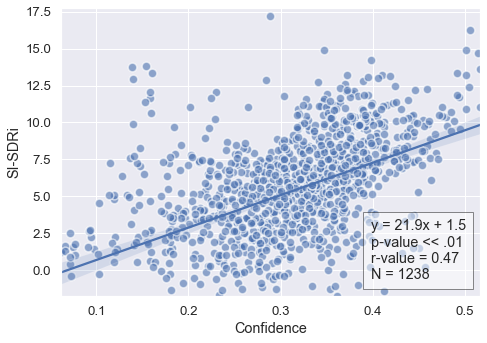

In [128]:
gin.parse_config_file('../musdb/exp/segment_and_separate/PrimitiveClusteringTrain/config.gin')
results_folder = _fix_path(os.path.join(src.helpers.output_folder(), 'results'))
json_files = glob.glob(f"{results_folder}/*.json")
df = nussl.evaluation.aggregate_score_files(json_files)

plt.figure(figsize=(7,5))
create_regression_plot(df, 'SI-SDRi', 'vocals')
plt.tight_layout()
plt.savefig('assets/figures/pcl_confidence_corr.png', dpi=300)
plt.show()

We observe a strong correlation between confidence and SI-SDRi. We can
also investigate the relationship in a different way. We can sort
the segments by confidence, and look at the distributions of SI-SDRi
within a range of the confidence measure, using percentiles.

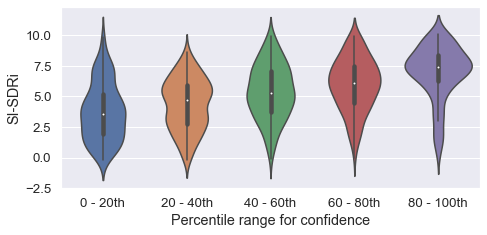

In [129]:
plt.figure(figsize=(7,3.5))
create_sdr_filter_plot(df, 'SI-SDRi', 'vocals')
plt.tight_layout()
plt.savefig('assets/figures/pcl_confidence_sift.png', dpi=300)
plt.show()

We can see that as confidence increases, the ground truth
performance within each band also increases. This shows that
we can extract high-quality separated sources in an
automated way.

### Relationship between confidence and genre

We now examine the confidence of primitive clustering on a 
much larger dataset of songs that have been downloaded from
YouTube. These songs are across many genres, but we do not have
ground truth isolated sources for them. However, we can now - 
using the genre labels - show which genres that primitive 
clustering is successful in separating versus which genres
it fails on.

The same procedure is applied as above: each song is split into
30 second segments with 15 second overlap. Primitive clustering is
run on each segment and the confidence measure is computed for
each segment. We then show the distribution of the confidence
measure within each genre. Since the confidence measure is
somewhat predictive of performance, we can draw some conclusions
about what sort of music primitive clustering is effective on.

In [130]:
LABELS = {
    'train': 'unknown', 
    'valid': 'unknown', 
    'rock': 'rock', 
    'decades': 'rock', 
    'classical': 'classical', 
    'pop': 'pop', 
    'pop2': 'pop',
    'jazz': 'jazz',
    'opera': 'opera',
    'oldies': 'oldies',
    'violin_concertos': 'classical',
}

def construct_dataframe_from_json(json_path):
    json_files = glob.glob(f"{json_path}/**/*.json", recursive=True)
    df = nussl.evaluation.aggregate_score_files(json_files)
    df['confidence'] = df['silhouette_confidence'] * df['posterior_confidence']

    file_dict = {os.path.basename(x): x for x in json_files}

    def get_metadata(row):
        idx = 1 if row['source'] == 'vocals' else 0
        json_path = file_dict[row['file']]
        with open(json_path, 'r') as f:
            data = json.load(f)
        row['original_path'] = data['metadata']['original_path']
        row['separated_path'] = data['metadata']['separated_path'][idx]
        row['label'] = 'unknown'
        for label in LABELS:
            if label in row['original_path']:
                row['label'] = label
                row['genre'] = LABELS[label]
                break
        
        return row
        
    df = df.progress_apply(lambda x: get_metadata(x), axis=1)
    return df

gin.parse_config_file('../musdb/exp/segment_and_separate/PrimitiveClusteringYouTube/config.gin')
results_folder = _fix_path(os.path.join(src.helpers.output_folder(), 'results'))
df_pcl_yt = construct_dataframe_from_json(results_folder)

100%|██████████| 52792/52792 [03:40<00:00, 239.33it/s]


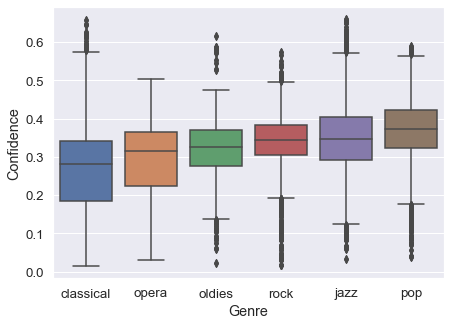

In [131]:
mask = df_pcl_yt['genre'] != 'unknown'
_df = df_pcl_yt[mask]

_df = group_and_return(_df, 'genre', 'confidence')

plt.figure(figsize=(7, 5))
sns.boxplot(x='variable', y='value', data=pd.melt(_df))
plt.ylabel('Confidence')
plt.xlabel('Genre')
plt.show()

We see that primitive clustering is the most confident on pop, rock, and jazz
genres. These genres generally exhibit repeating backgrounds, percussive
backgrounds versus foreground instruments or vocals. The cues used by
primitive clustering are also the ones used by the composers of
these genres to make the vocals or foreground instrument pop out 
more. However, in the lowest scoring genres are classical and 
opera where such cues are not present.

### Audio examples of high and low confidence

We now show audio examples of high and low confidence separated
sources.

In [170]:
def visualize_and_embed(sources, title):
    plt.figure(figsize=(15, 4))
    plt.subplot(111)
    ax = plt.gca()
    ax.grid(False)
    plt.title(title)
    nussl.utils.visualize_sources_as_masks(sources,
        y_axis='mel', db_cutoff=-80, alpha_amount=2.0)
    plt.tight_layout()
    plt.show()
    nussl.play_utils.multitrack(sources)

def get_random_draw(df_source, mask, replace_path='pcl', use_replace_path=True):
    accepted = False
    while not accepted:
        accepted = True
        idx = np.random.randint(df_source[mask].shape[0])
        audio_file = df_source[['file']][mask].values.tolist()[idx][0].replace('.json', '')
        source_audio = {}

        for i, name in enumerate(['Background', 'Foreground']):
            audio_path = df_source[mask].iloc[idx]['separated_path'].replace('s1', f's{i}')
            if use_replace_path:
                audio_path = f"assets/audio/{replace_path}/s{i}/{audio_path.split('/')[-1]}"
            signal = nussl.AudioSignal(audio_path)
            if not use_replace_path:
                signal.write_audio_to_file(f'assets/audio/{replace_path}/s{i}/{signal.file_name}')
            source_audio[name] = signal
        
        mix = sum(source_audio.values())
         # if there's more than 5 low energy seconds in either source
        for i, signal in enumerate(source_audio.values()):
            rms = signal.rms(
                win_len=signal.sample_rate, 
                hop_len=signal.sample_rate // 2
            )
            if (rms < 1e-2).sum() > 15:
                accepted = False
            elif mix.loudness() < -60:
                accepted = False
            
    return source_audio, idx, audio_file

df_pcl_yt_source = df_pcl_yt[df_pcl_yt['source'] == 'vocals']
num_draws = 2
low, high = 20, 80

#### High-confidence separations

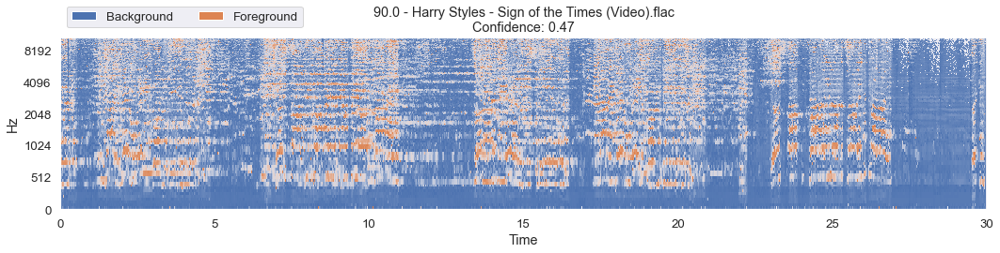


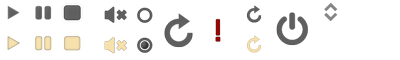
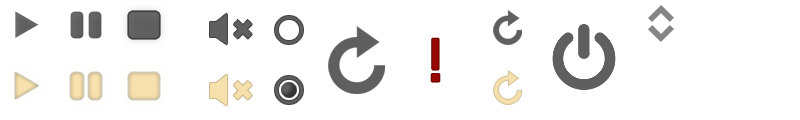
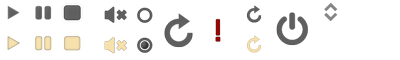

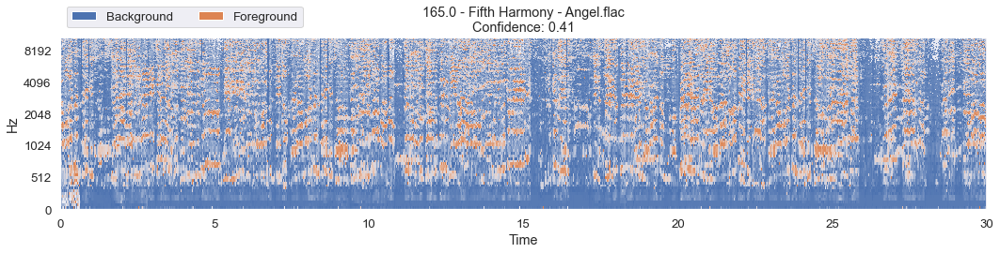


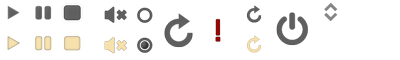
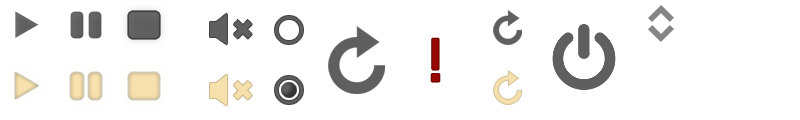
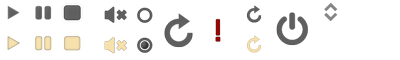

In [171]:
np.random.seed(1234)
mask = df_pcl_yt_source['genre'].isin(['rock', 'pop', 'opera'])
mask *= (
    df_pcl_yt_source['confidence'] >= 
    np.percentile(df_pcl_yt_source['confidence'], high)
)

allowed_files = [f'{x}.json' for x in os.listdir('assets/audio/pcl/s0/')]
mask *= df_pcl_yt_source['file'].isin(allowed_files)

for j in range(num_draws):  
    source_audio, idx, audio_file = get_random_draw(df_pcl_yt_source, mask)
    title = f"{audio_file}\nConfidence: {df_pcl_yt_source[mask]['confidence'].iloc[idx]:.2f}"
    visualize_and_embed(source_audio, title)

#### Low-confidence separations

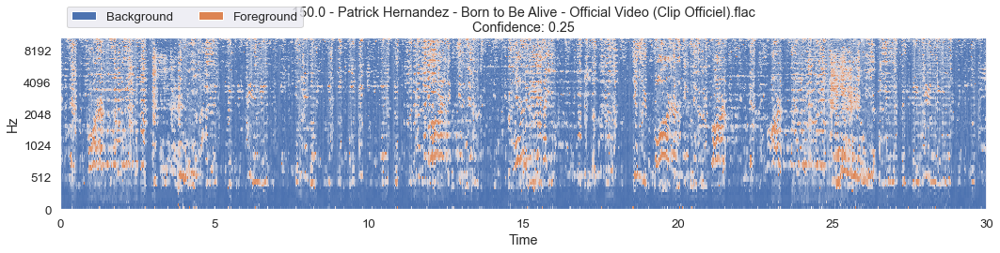


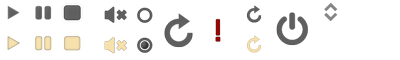
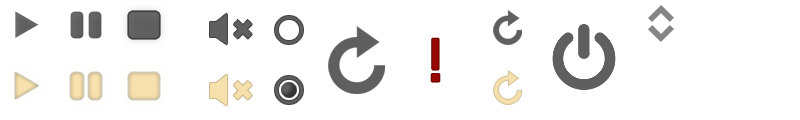
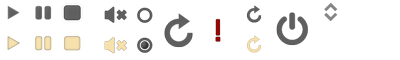

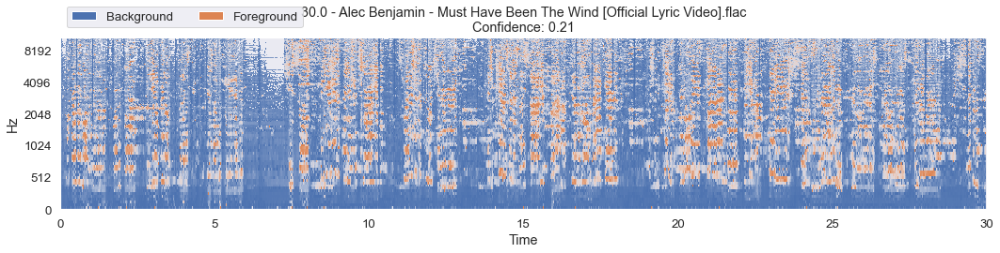


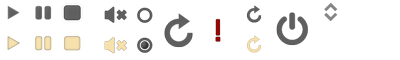
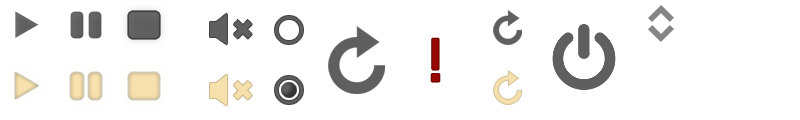
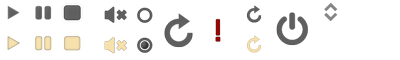

In [172]:
np.random.seed(1234)

mask = df_pcl_yt_source['genre'].isin(['rock', 'pop', 'opera'])
mask *= (
    df_pcl_yt_source['confidence'] < 
    np.percentile(df_pcl_yt_source['confidence'], low)
)

allowed_files = [f'{x}.json' for x in os.listdir('assets/audio/pcl/s0/')]
mask *= df_pcl_yt_source['file'].isin(allowed_files)

for j in range(num_draws):  
    source_audio, idx, audio_file = get_random_draw(df_pcl_yt_source, mask)
    title = f"{audio_file}\nConfidence: {df_pcl_yt_source[mask]['confidence'].iloc[idx]:.2f}"
    visualize_and_embed(source_audio, title)

## Part three: bootstrapping via remixing

We now train a model off the output of primitive clustering. We first
investigate the impact of the confidence measure on the performance of the 
trained model. First, we describe how we construct training data.

To construct a single training example, we take separated 
accompaniment audio and separated vocals audio and mix them
together. These can be either from the same song (coherent mixing) 
or from different songs (incoherent mixing). The separations
are produced by primitive clustering. These mixes are training data for 
the bootstrapped models.

### Impact of confidence on performance

First, we investigate the impact of the confidence measure
on the bootstrapped model performance. The data that is selected
for remixing is done so using the confidence measure. We use
mixes from each quintile of the MUSDB train set by confidence
to train 5 different models. The expectation is that the
lower our confidence in the separated sources, the worse the
performance of the bootstrapped model.

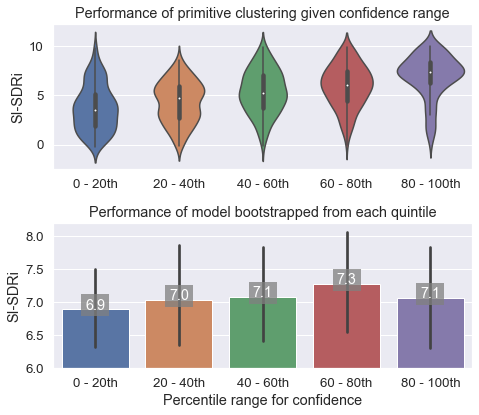

In [135]:
def compare_approaches(config_files, **kwargs):
    dfs = []
    for config_file, approach in config_files:
        if isinstance(config_file, str):
            dfs.append(collect_results(config_file, approach))
        else:
            dfs.append(config_file)
    df = pd.concat(dfs)

    ax = sns.barplot(x='approach', y='SI-SDRi', data=df, **kwargs)

    for i, approach in enumerate([x[1] for x in config_files]):
        _mean = df[df['approach'] == approach]['SI-SDRi'].mean()
        t = ax.text(i, _mean, round(_mean, 1), 
                    color='white', ha="center")
        t.set_bbox(dict(facecolor='gray', alpha=.75, edgecolor='none'))

    plt.xlabel("Approach")
    plt.ylabel("SI-SDRi (dB)")
    plt.tight_layout()
    
    return ax
    

config_files = [
    ('../musdb/exp/models/BootstrapMUSDBIncoherent/Q1/config.gin', '0 - 20th'),
    ('../musdb/exp/models/BootstrapMUSDBIncoherent/Q2/config.gin', '20 - 40th'),
    ('../musdb/exp/models/BootstrapMUSDBIncoherent/Q3/config.gin', '40 - 60th'),
    ('../musdb/exp/models/BootstrapMUSDBIncoherent/Q4/config.gin', '60 - 80th'),
    ('../musdb/exp/models/BootstrapMUSDBIncoherent/Q5/config.gin', '80 - 100th'),
]

plt.figure(figsize=(7, 6))
plt.subplot(212)
ax = compare_approaches(config_files)
plt.xlabel("Percentile range for confidence")
plt.ylabel("SI-SDRi")
plt.title("Performance of model bootstrapped from each quintile")
plt.ylim([6, 8.2])

gin.parse_config_file('../musdb/exp/segment_and_separate/PrimitiveClusteringTrain/config.gin')
results_folder = _fix_path(os.path.join(src.helpers.output_folder(), 'results'))
json_files = glob.glob(f"{results_folder}/*.json")
df = nussl.evaluation.aggregate_score_files(json_files)

plt.subplot(211)
plt.title("Performance of primitive clustering given confidence range")
create_sdr_filter_plot(df, 'SI-SDRi', 'vocals')
plt.xlabel('')
plt.tight_layout()
plt.savefig('assets/figures/sift_bs_perf_1sigfig.pdf')
plt.show()

We observe that as confidence in the separated sources increases, so does
the performance of the model that is trained from remixes of
those separated sources. This continues until the highest
percentile range, where there is a drop in performance. The drop
is likely because these mixtures are simpler (e.g. drum + vocals),
and so remixes of the separated sources do not capture the
full complexity of the test set mixtures, leading to a drop in
performance.

### Impact of adding more data

The models above were trained on very little data (separations from
around 25 songs, each). We now study the impact of adding many 
more songs into the training set.

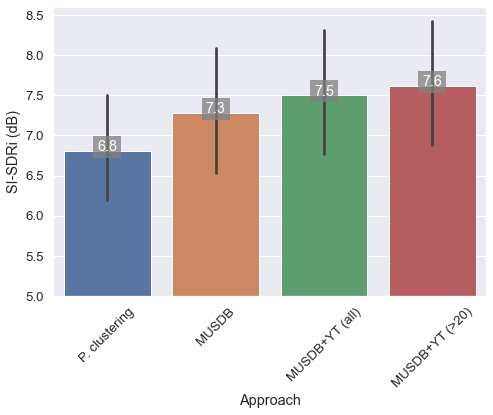

In [136]:
config_files = [
    ('../musdb/exp/primitives/PrimitiveClustering/config.gin', 'P. clustering'),
    ('../musdb/exp/models/BootstrapMUSDBIncoherent/Q4/config.gin', 'MUSDB'),
    (collect_results('../musdb/exp/models/BootstrapYoutube/Q2-Q5/config.gin', 'MUSDB+YT (all)', 'results_all'), 'MUSDB+YT (all)'),
    ('../musdb/exp/models/BootstrapYoutube/Q2-Q5/config.gin', 'MUSDB+YT (>20)'),
]

plt.figure(figsize=(7, 5))
ax = compare_approaches(config_files)
for item in ax.get_xticklabels():
    item.set_rotation(45)
plt.ylim([5, 8.6])
plt.show()

Adding more data has a significant effect on model performance. 
The performance can be further improved by again using the
confidence measure to exclude the bottom quintile from the
remixing process.

### Bootstrapping from bootstrapping

The model we train is a Chimera model, which combines a mask-inference 
head with a deep-clustering head. The clustering head is not used for
actual separation but is used instead as a regularizer for the
mask-inference head during training. However, we can apply the same 
confidence measure to the bootstrapped model by analyzing the embedding space
produced by the deep-clustering head.

In this section, we show how we can repeat the entire bootstrapping 
process one more time, this time using the bootstrapped model as the
separator.

##### Correlation of confidence measure to SI-SDRi for bootstrapped model

First, we show that the confidence measure correlates with ground truth
performance for the bootstrapped model.

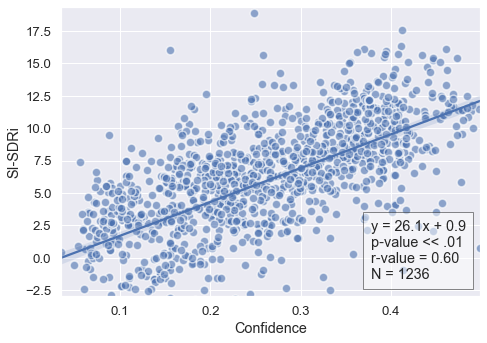

In [137]:
gin.parse_config_file('../musdb/exp/segment_and_separate/DeepClusteringTrain/config.gin')
results_folder = _fix_path(os.path.join(src.helpers.output_folder(), 'results'))
json_files = glob.glob(f"{results_folder}/*.json")
df = nussl.evaluation.aggregate_score_files(json_files)

plt.figure(figsize=(7,5))
create_regression_plot(df, 'SI-SDRi', 'vocals')
plt.tight_layout()
plt.savefig('assets/figures/deep_conf_corr.png', dpi=300)
plt.show()

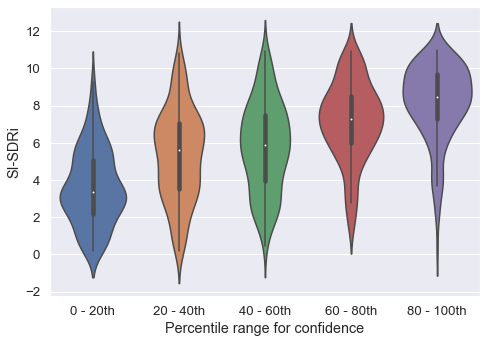

In [138]:
plt.figure(figsize=(7,5))
create_sdr_filter_plot(df, 'SI-SDRi', 'vocals')
plt.tight_layout()
plt.show()

Next, we show the performance of the model bootstrapped from the bootstrapped model,
versus the best model found so far (bootstrapping from YouTube + MUSDB, with a confidence cutoff
at the 20th percentile).

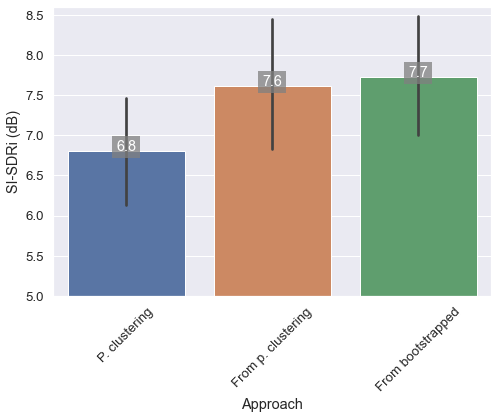

In [139]:
config_files = [
    ('../musdb/exp/primitives/PrimitiveClustering/config.gin', 'P. clustering'),
    ('../musdb/exp/models/BootstrapYoutube/Q2-Q5/config.gin', 'From p. clustering'),
    ('../musdb/exp/models/BootstrapYoutube/DPCL-Q2-Q5/config.gin', 'From bootstrapped'),
]

plt.figure(figsize=(7, 5))
ax = compare_approaches(config_files)
for item in ax.get_xticklabels():
    item.set_rotation(45)
plt.ylim([5, 8.6])
plt.show()

We see that further gains are possible by bootstrapping from the
bootstrapped model.

### Audio examples

Remember to scroll up to hear the primitive separations to compare!
Primitive clustering will be placed here as well for direct and
easy comparison of separation quality.

#### Bootstrap from 60-80th quintile of MUSDB

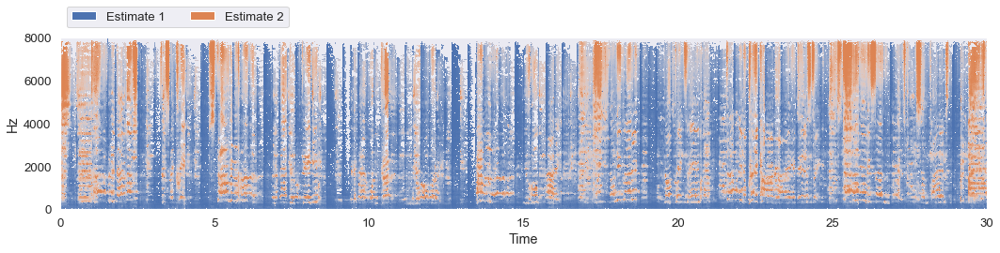


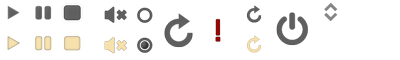
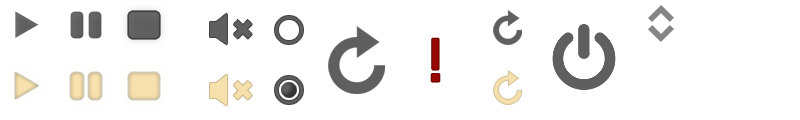
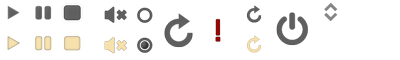

In [173]:
config_file = '../musdb/exp/models/BootstrapMUSDBIncoherent/Q4/config.gin'
estimates = separate_run_viz(mix, config_file)
all_vocal_estimates['Bootstrap from 60-80th quintile of MUSDB'] = estimates['Estimate 2']

#### Bootstrap from MUSDB + YouTube data (>20th percentile)

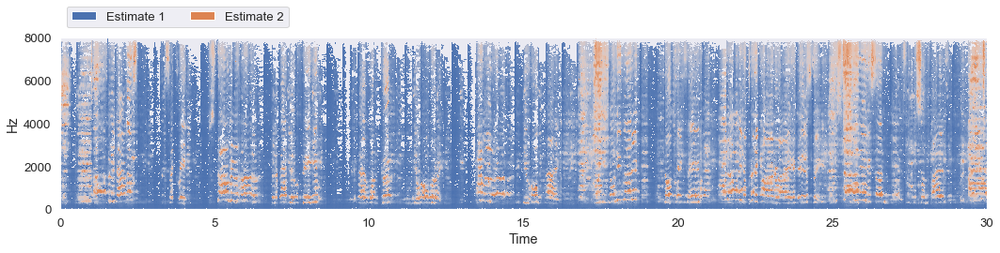


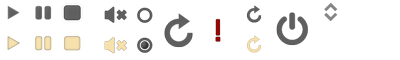
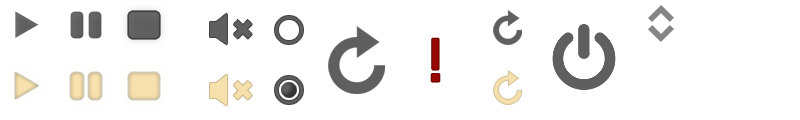
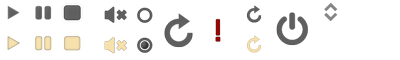

In [174]:
config_file = '../musdb/exp/models/BootstrapYoutube/Q2-Q5/config.gin'
estimates = separate_run_viz(mix, config_file)
all_vocal_estimates['Bootstrap from MUSDB + YouTube'] = estimates['Estimate 2']

#### Bootstrap from bootstrapping

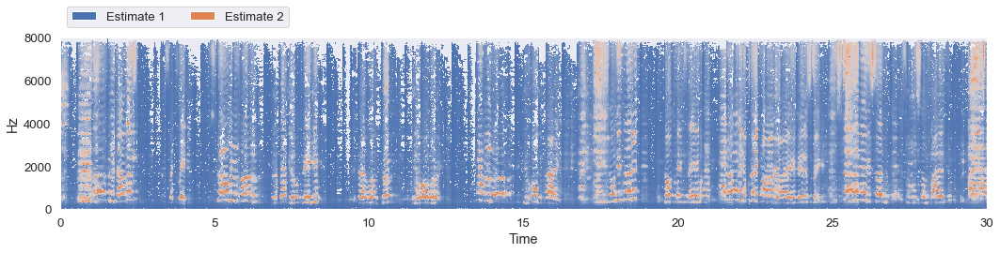


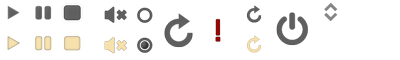
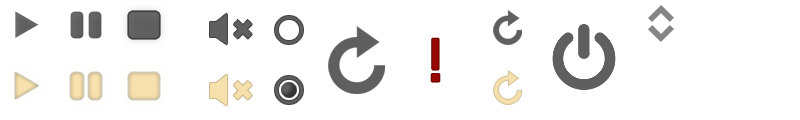
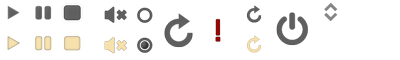

In [175]:
config_file = '../musdb/exp/models/BootstrapYoutube/DPCL-Q2-Q5/config.gin'
estimates = separate_run_viz(mix, config_file)
all_vocal_estimates['Bootstrap from bootstrapping'] = estimates['Estimate 2']

#### Trained from scratch on ground truth

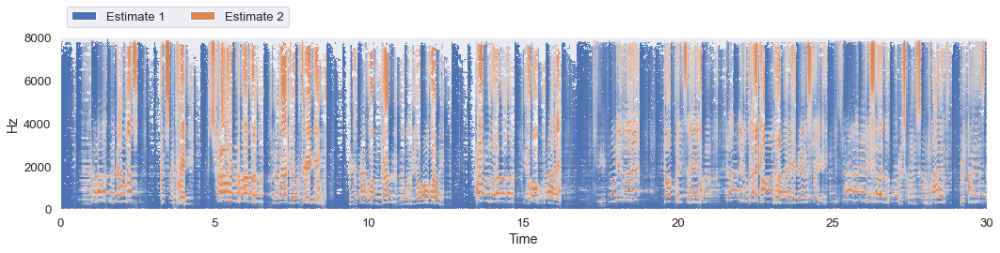


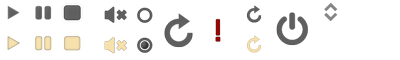
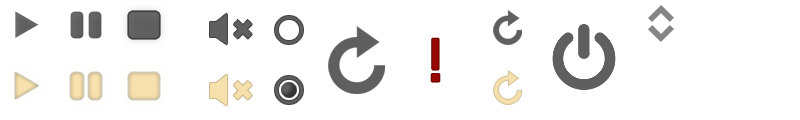
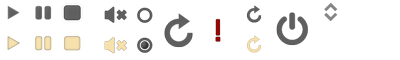

In [176]:
config_file = '../musdb/exp/models/GroundTruthMel300-25Epochs/config.gin'
estimates = separate_run_viz(mix, config_file)
all_vocal_estimates['Trained on ground truth'] = estimates['Estimate 2']

#### Trained starting with bootstrapped model on MUSDB train set

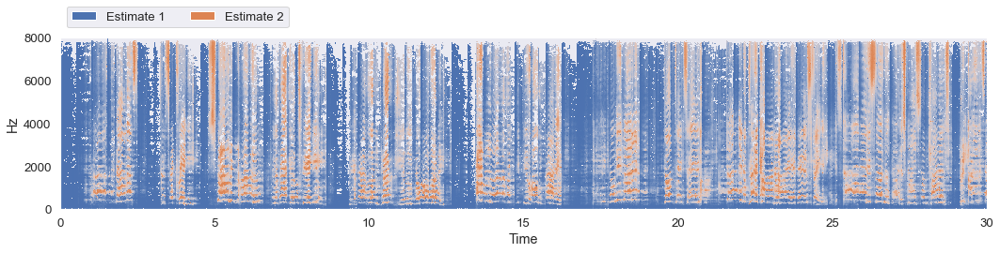


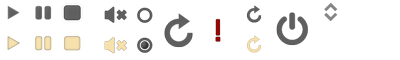
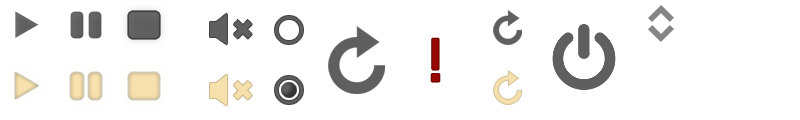
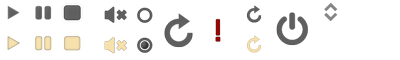

In [177]:
config_file = '../musdb/exp/models/BootstrapYoutube/FineTune/config.gin'
estimates = separate_run_viz(mix, config_file)
all_vocal_estimates['Fine tuned to train set'] = estimates['Estimate 2']

### Comparing all approaches

Below we show every vocal estimate from each approach for one song. 
One can switch between them to compare vocal separation quality between 
methods.


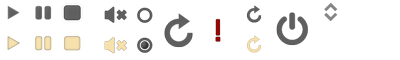
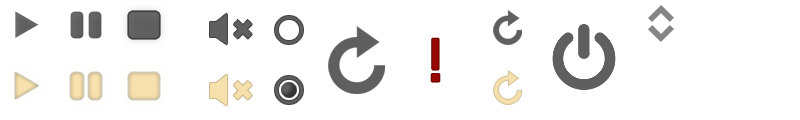
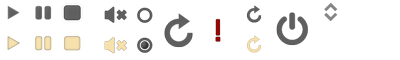

In [147]:
_estimates = copy.deepcopy(all_vocal_estimates)
for key, val in _estimates.items():
    _estimates[key] = val * 1 / (1 + len(estimates))
nussl.play_utils.multitrack(_estimates)

### Results for all models

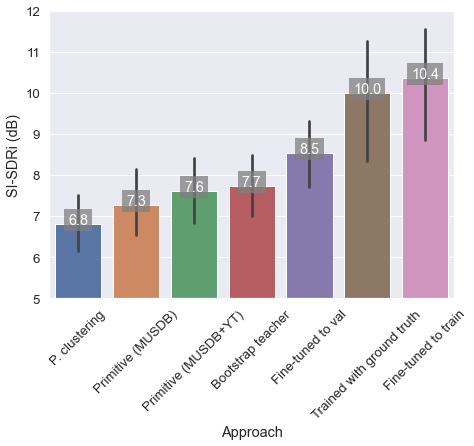

In [148]:
config_files = [
    ('../musdb/exp/primitives/PrimitiveClustering/config.gin', 'P. clustering'),
    ('../musdb/exp/models/BootstrapMUSDBIncoherent/Q4/config.gin', 'Primitive (MUSDB)'),
    ('../musdb/exp/models/BootstrapYoutube/Q2-Q5/config.gin', 'Primitive (MUSDB+YT)'),
    ('../musdb/exp/models/BootstrapYoutube/DPCL-Q2-Q5/config.gin', 'Bootstrap teacher'),
    ('../musdb/exp/models/BootstrapYoutube/FineTuneToSubset/config.gin', 'Fine-tuned to val'),
    ('../musdb/exp/models/GroundTruthMel300-25Epochs/config.gin', 'Trained with ground truth'),
    ('../musdb/exp/models/BootstrapYoutube/FineTune/config.gin', 'Fine-tuned to train')
]

plt.figure(figsize=(7, 5))
ax = compare_approaches(config_files)
for item in ax.get_xticklabels():
    item.set_rotation(45)
plt.ylim([5, 12])
plt.show()

# Appendix

#### High-confidence separations in jazz

One advantage of the approach described in this work is that 
the system can learn to separate different instruments in genres
where we have limited training data. For example, jazz.

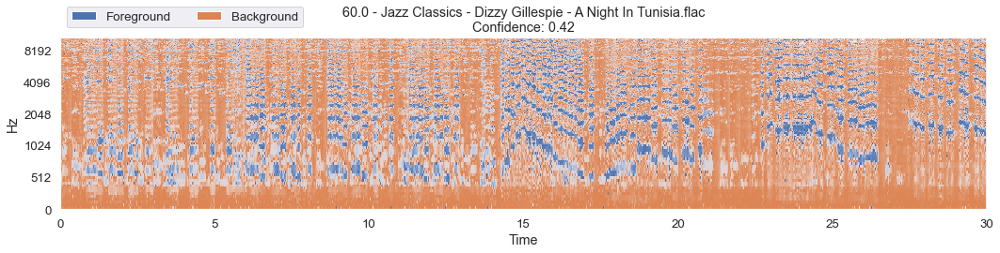


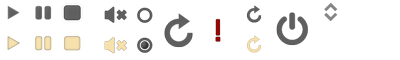
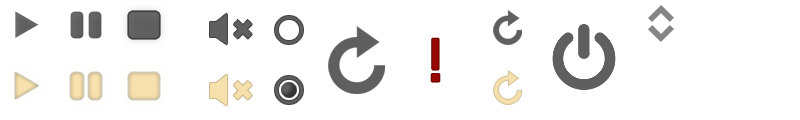
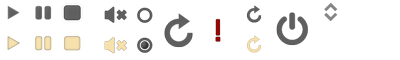

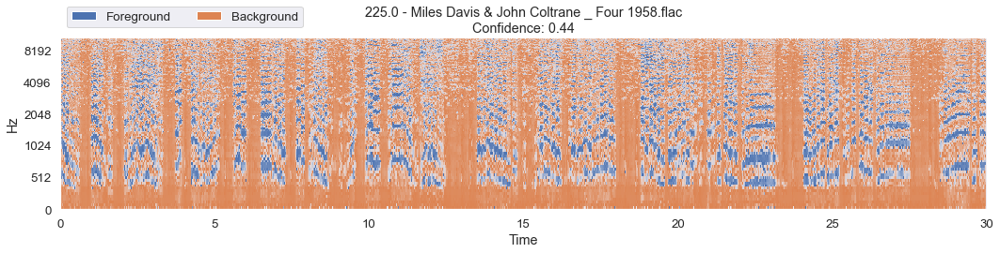


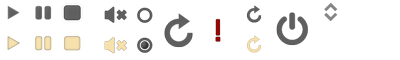
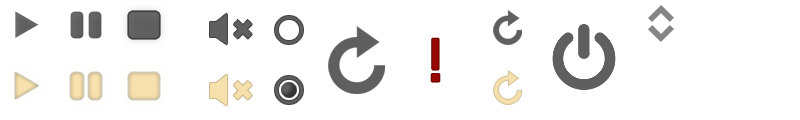
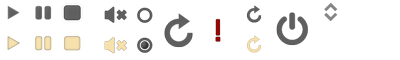

In [178]:
np.random.seed(1234)

mask = df_pcl_yt_source['genre'].isin(['jazz'])
mask *= (
    df_pcl_yt_source['confidence'] >= 
    np.percentile(df_pcl_yt_source['confidence'], high)
)
allowed_files = [f'{x}.json' for x in os.listdir('assets/audio/pcl/s0/')]
mask *= df_pcl_yt_source['file'].isin(allowed_files)

for j in range(num_draws):  
    source_audio, idx, audio_file = get_random_draw(df_pcl_yt_source, mask)
    title = f"{audio_file}\nConfidence: {df_pcl_yt_source[mask]['confidence'].iloc[idx]:.2f}"
    visualize_and_embed(source_audio, title)

#### High-confidence separations from bootstrapped model

In [150]:
gin.parse_config_file('../musdb/exp/segment_and_separate/DeepClusteringYouTube/config.gin')
results_folder = _fix_path(os.path.join(src.helpers.output_folder(), 'results'))
df_deep_yt = construct_dataframe_from_json(results_folder)

100%|██████████| 52792/52792 [03:26<00:00, 255.89it/s]


In [179]:
df_deep_yt_source = df_deep_yt[df_deep_yt['source'] == 'vocals']
num_draws = 1
low, high = 20, 80

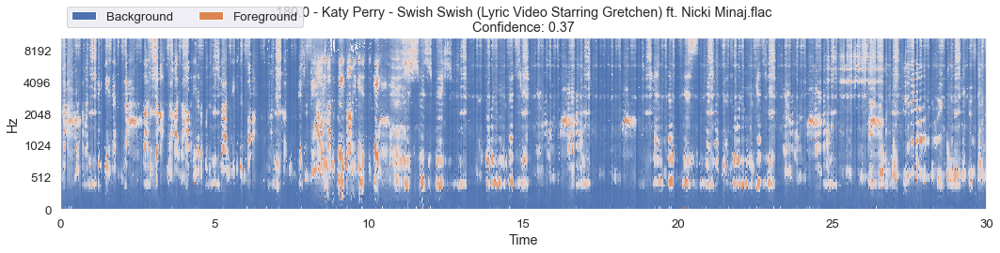


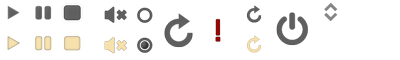
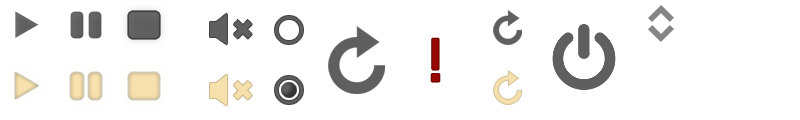
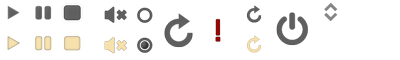

In [180]:
np.random.seed(1234)
mask = df_deep_yt_source['genre'].isin(['rock', 'pop', 'opera'])
mask *= (
    df_deep_yt_source['confidence'] >= 
    np.percentile(df_deep_yt_source['confidence'], high)
)
allowed_files = [f'{x}.json' for x in os.listdir('assets/audio/deep/s0/')]
mask *= df_pcl_yt_source['file'].isin(allowed_files)

for j in range(num_draws):  
    source_audio, idx, audio_file = get_random_draw(df_deep_yt_source, mask, replace_path='deep')
    title = f"{audio_file}\nConfidence: {df_deep_yt_source[mask]['confidence'].iloc[idx]:.2f}"
    visualize_and_embed(source_audio, title)

#### Low-confidence separations from bootstrapped model

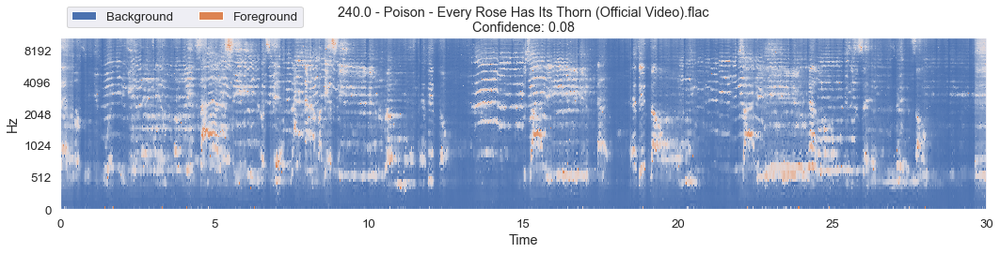


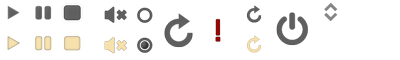
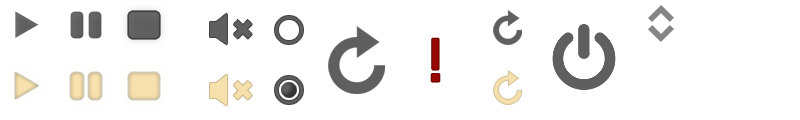
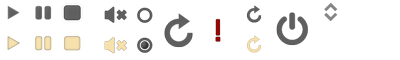

In [181]:
np.random.seed(1234)
mask = df_deep_yt_source['genre'].isin(['rock', 'pop', 'opera'])
mask *= (
    df_deep_yt_source['confidence'] < 
    np.percentile(df_deep_yt_source['confidence'], low)
)
allowed_files = [f'{x}.json' for x in os.listdir('assets/audio/deep/s0/')]
mask *= df_pcl_yt_source['file'].isin(allowed_files)

for j in range(num_draws):  
    source_audio, idx, audio_file = get_random_draw(df_deep_yt_source, mask, replace_path='deep')
    title = f"{audio_file}\nConfidence: {df_deep_yt_source[mask]['confidence'].iloc[idx]:.2f}"
    visualize_and_embed(source_audio, title)